# -------------------------------------Skin Disorder Detection--------------------------------------

## Introduction -

- The differential diagnosis of erythemato-squamous diseases is a real problem in dermatology. They all share the clinical features of erythema and scaling, with very little differences. The diseases in this group are psoriasis,  seboreic dermatitis,  lichen planus,  pityriasis rosea,  cronic dermatitis and pityriasis rubra pilaris. Usually a biopsy is necessary for the diagnosis but unfortunately, these diseases share many histopathological features as well.
- Another difficulty for the differential diagnosis is that a disease may show the features of another disease at the beginning stage and may have the characteristic features at the following stages. Patients were first evaluated clinically with 12 features. Afterwards, skin samples were taken for the evaluation of 22 histopathological features. The values of the histopathological features are determined by an analysis of the samples under a microscope.

- The names and id numbers of the patients were recently removed from the database.


## Domain Analysis -

- In the dataset constructed for this domain, the family history feature has the value 1 if any of these diseases has been observed in the family, and 0 otherwise. The age feature simply represents the age of the patient. Every other feature (clinical and histopathological) was given a degree in the range of 0 to 3. Here, 0 indicates that the feature was not present, 3 indicates the largest amount possible, and 1, 2 indicate the relative intermediate values.


Number of Instances: 366

Number of Attributes: 34

Attribute Information:
   -- Complete attribute documentation:
      
      Clinical Attributes: (take values 0, 1, 2, 3, unless otherwise indicated)
      1: erythema
      2: scaling
      3: definite borders
      4: itching
      5: koebner phenomenon
      6: polygonal papules
      7: follicular papules
      8: oral mucosal involvement
      9: knee and elbow involvement
     10: scalp involvement
     11: family history, (0 or 1)
     34: Age (linear)

     Histopathological Attributes: (take values 0, 1, 2, 3)
     12: melanin incontinence
     13: eosinophils in the infiltrate
     14: PNL infiltrate
     15: fibrosis of the papillary dermis
     16: exocytosis
     17: acanthosis
     18: hyperkeratosis
     19: parakeratosis
     20: clubbing of the rete ridges
     21: elongation of the rete ridges
     22: thinning of the suprapapillary epidermis
     23: spongiform pustule
     24: munro microabcess
     25: focal hypergranulosis
     26: disappearance of the granular layer
     27: vacuolisation and damage of basal layer
     28: spongiosis
     29: saw-tooth appearance of retes
     30: follicular horn plug
     31: perifollicular parakeratosis
     32: inflammatory monoluclear inflitrate
     33: band-like infiltrate

- Missing Attribute Values: 8 (in Age attribute). Distinguished with '?'

- Class Distribution:
       Database:  Dermatology
       
       Class code:   Class:                  Number of instances:
       1             psoriasis			    112
       2             seboreic dermatitis             61
       3             lichen planus                   72
       4             pityriasis rosea                49
       5             cronic dermatitis               52    
       6             pityriasis rubra pilaris        20

### Importing libraries and loading the data -

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

In [2]:
data = pd.read_csv("dermatology.csv",header=None)

In [3]:
df = data.copy()

In [4]:
df

,0,1,2,3,4,5,6,7,8,9,...,25,26,27,28,29,30,31,32,33,34
0,2,2,0,3,0,0,0,0,1,0,...,0,0,3,0,0,0,1,0,55,2
1,3,3,3,2,1,0,0,0,1,1,...,0,0,0,0,0,0,1,0,8,1
2,2,1,2,3,1,3,0,3,0,0,...,0,2,3,2,0,0,2,3,26,3
3,2,2,2,0,0,0,0,0,3,2,...,3,0,0,0,0,0,3,0,40,1
4,2,3,2,2,2,2,0,2,0,0,...,2,3,2,3,0,0,2,3,45,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
361,2,1,1,0,1,0,0,0,0,0,...,0,0,1,0,0,0,2,0,25,4
362,3,2,1,0,1,0,0,0,0,0,...,1,0,1,0,0,0,2,0,36,4
363,3,2,2,2,3,2,0,2,0,0,...,0,3,0,3,0,0,2,3,28,3
364,2,1,3,1,2,3,0,2,0,0,...,0,2,0,1,0,0,2,3,50,3


In [5]:
pd.set_option("display.max_columns", None)

In [6]:
df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34
0,2,2,0,3,0,0,0,0,1,0,0,0,0,0,0,3,2,0,0,0,0,0,0,0,0,0,0,3,0,0,0,1,0,55,2
1,3,3,3,2,1,0,0,0,1,1,1,0,0,1,0,1,2,0,2,2,2,2,2,1,0,0,0,0,0,0,0,1,0,8,1
2,2,1,2,3,1,3,0,3,0,0,0,1,0,0,0,1,2,0,2,0,0,0,0,0,2,0,2,3,2,0,0,2,3,26,3
3,2,2,2,0,0,0,0,0,3,2,0,0,0,3,0,0,2,0,3,2,2,2,2,0,0,3,0,0,0,0,0,3,0,40,1
4,2,3,2,2,2,2,0,2,0,0,0,1,0,0,0,1,2,0,0,0,0,0,0,0,2,2,3,2,3,0,0,2,3,45,3


## Basic Checks -

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 366 entries, 0 to 365
Data columns (total 35 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       366 non-null    int64 
 1   1       366 non-null    int64 
 2   2       366 non-null    int64 
 3   3       366 non-null    int64 
 4   4       366 non-null    int64 
 5   5       366 non-null    int64 
 6   6       366 non-null    int64 
 7   7       366 non-null    int64 
 8   8       366 non-null    int64 
 9   9       366 non-null    int64 
 10  10      366 non-null    int64 
 11  11      366 non-null    int64 
 12  12      366 non-null    int64 
 13  13      366 non-null    int64 
 14  14      366 non-null    int64 
 15  15      366 non-null    int64 
 16  16      366 non-null    int64 
 17  17      366 non-null    int64 
 18  18      366 non-null    int64 
 19  19      366 non-null    int64 
 20  20      366 non-null    int64 
 21  21      366 non-null    int64 
 22  22      366 non-null    in

In [8]:
df.describe()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,34
count,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000,366.000000
mean,2.068306,1.795082,1.549180,1.366120,0.633880,0.448087,0.166667,0.377049,0.614754,0.519126,0.125683,0.404372,0.139344,0.546448,0.336066,1.368852,1.956284,0.527322,1.289617,0.663934,0.991803,0.633880,0.295082,0.363388,0.393443,0.464481,0.456284,0.953552,0.453552,0.103825,0.114754,1.866120,0.554645,2.803279
std,0.664753,0.701527,0.907525,1.138299,0.908016,0.957327,0.570588,0.834147,0.982979,0.905639,0.331946,0.869818,0.411790,0.815451,0.853139,1.104418,0.712512,0.757116,0.917562,1.056829,1.162161,1.034924,0.670578,0.759721,0.849406,0.864899,0.954873,1.130172,0.954744,0.450433,0.488723,0.726108,1.105908,1.597803
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000
50%,2.000000,2.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,2.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,3.000000
75%,2.000000,2.000000,2.000000,2.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,2.000000,2.000000,1.000000,2.000000,2.000000,2.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,2.000000,0.000000,4.000000
max,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,1.000000,3.000000,2.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,6.000000


In [9]:
df.describe(include="O")

,33
count,366
unique,61
top,40
freq,17


In [10]:
df[34].value_counts()

1    112
3     72
2     61
5     52
4     49
6     20
Name: 34, dtype: int64

### Renaming columns : 

In [11]:
col_list = []
for i in range(1,36):
    if i < 34:
        col_list.append("feature{}".format(i))
    elif i < 35:
        col_list.append("age")
    else:
        col_list.append("target")

In [12]:
df.columns = col_list

In [13]:
df

,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13,feature14,feature15,feature16,feature17,feature18,feature19,feature20,feature21,feature22,feature23,feature24,feature25,feature26,feature27,feature28,feature29,feature30,feature31,feature32,feature33,age,target
0,2,2,0,3,0,0,0,0,1,0,0,0,0,0,0,3,2,0,0,0,0,0,0,0,0,0,0,3,0,0,0,1,0,55,2
1,3,3,3,2,1,0,0,0,1,1,1,0,0,1,0,1,2,0,2,2,2,2,2,1,0,0,0,0,0,0,0,1,0,8,1
2,2,1,2,3,1,3,0,3,0,0,0,1,0,0,0,1,2,0,2,0,0,0,0,0,2,0,2,3,2,0,0,2,3,26,3
3,2,2,2,0,0,0,0,0,3,2,0,0,0,3,0,0,2,0,3,2,2,2,2,0,0,3,0,0,0,0,0,3,0,40,1
4,2,3,2,2,2,2,0,2,0,0,0,1,0,0,0,1,2,0,0,0,0,0,0,0,2,2,3,2,3,0,0,2,3,45,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
361,2,1,1,0,1,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,2,0,25,4
362,3,2,1,0,1,0,0,0,0,0,0,0,0,0,0,2,2,0,0,0,0,0,0,0,0,1,0,1,0,0,0,2,0,36,4
363,3,2,2,2,3,2,0,2,0,0,0,2,2,0,0,3,3,0,0,0,0,0,0,0,3,0,3,0,3,0,0,2,3,28,3
364,2,1,3,1,2,3,0,2,0,0,0,2,0,0,0,3,2,0,0,0,0,0,0,0,3,0,2,0,1,0,0,2,3,50,3


In [14]:
df.target.value_counts()

1    112
3     72
2     61
5     52
4     49
6     20
Name: target, dtype: int64

In [15]:
df.age.value_counts()

40    17
50    17
36    16
27    16
22    15
      ..
58     1
49     1
63     1
68     1
75     1
Name: age, Length: 61, dtype: int64

## Data Visualiztion -

Alert! from autoviz version 0.1.35, after importing, you must %matplotlib inline to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
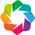

In [16]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()

In [17]:
%matplotlib inline

### Univariate Analysis :

Shape of your Data Set loaded: (366, 35)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    35 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
33 numeric variables in data exceeds limit, taking top 35 variables
Number of All Scatter Plots = 561
Image size of 1080x76032 pixels is too large. It must be less than 2^16 in each direction.
Could not draw Pair Scatter Plots


ValueError: Image size of 1080x76032 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 1080x76032 with 528 Axes>

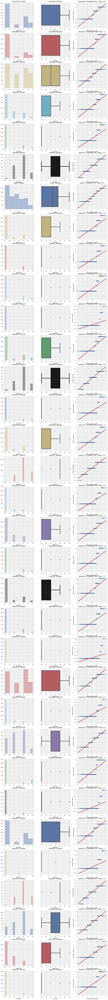

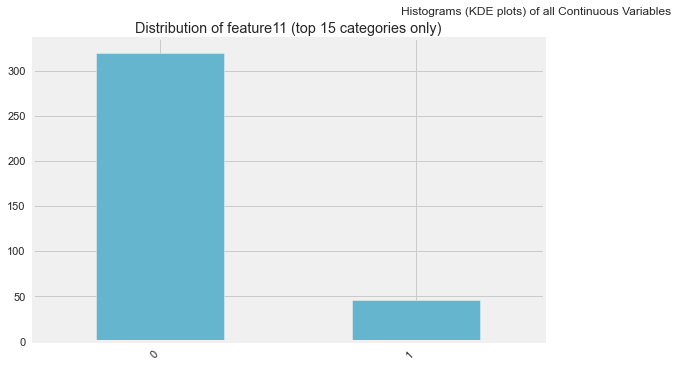

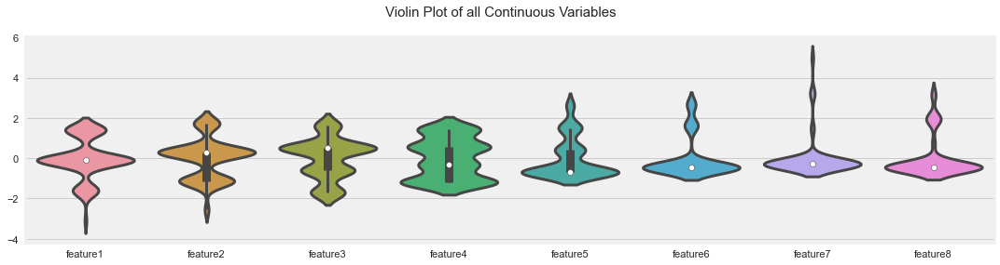

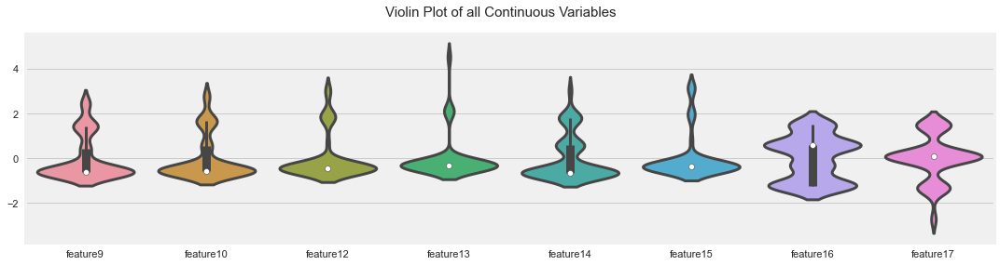

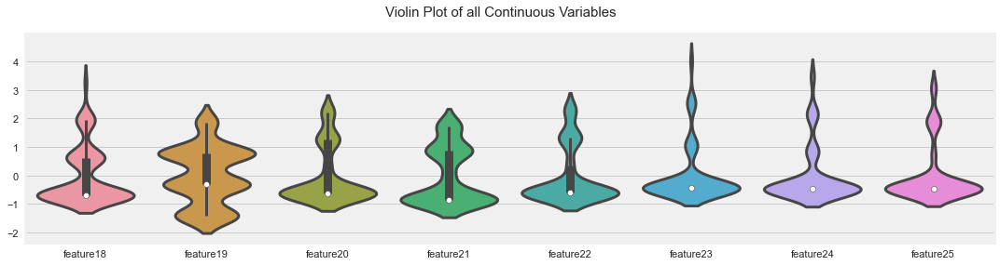

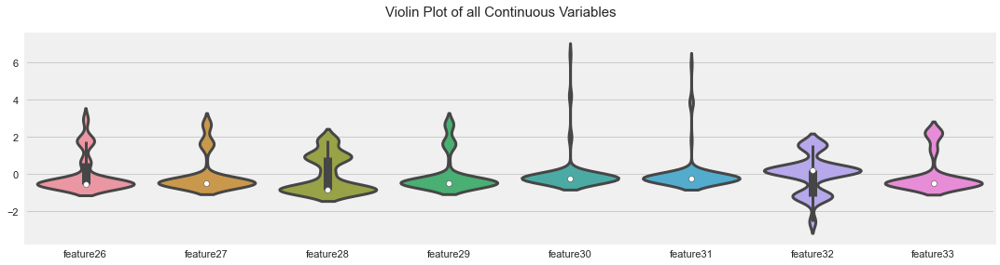

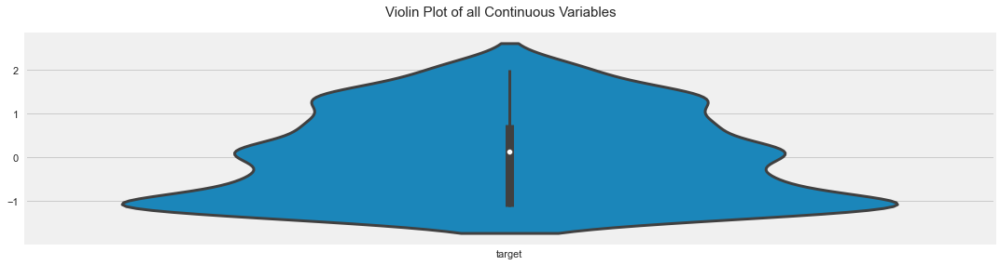

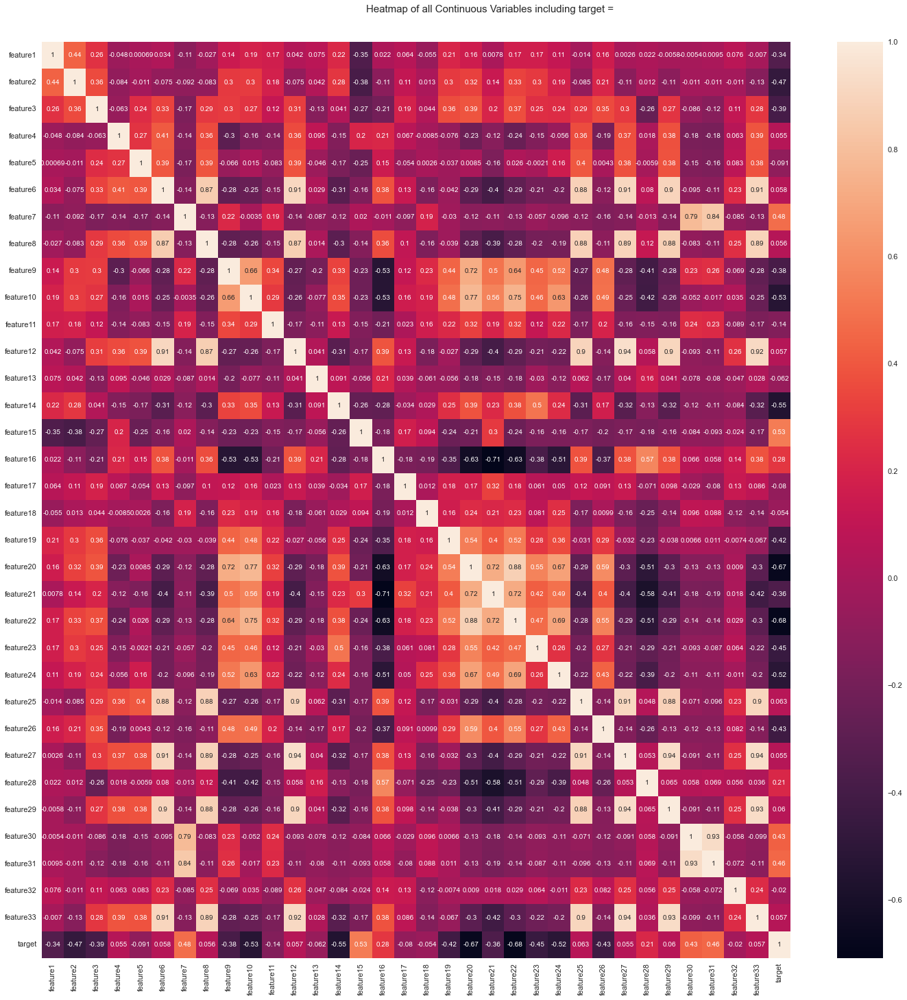

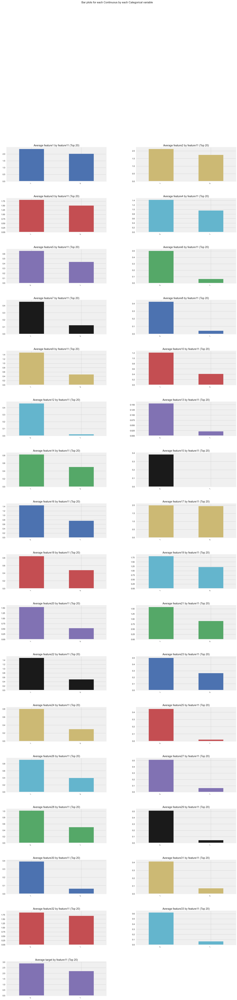

Could not draw wordcloud plot for age
Time to run AutoViz = 62 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


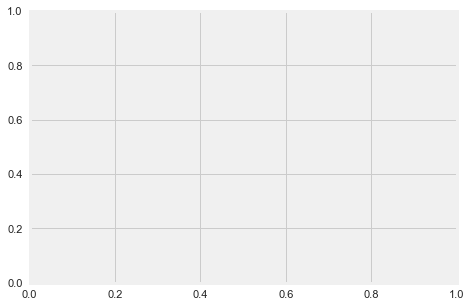

In [18]:
drft = AV.AutoViz(filename="", sep=",", depVar="", dfte=df, max_cols_analyzed= 35)

### Bivariate Analysis :

Shape of your Data Set loaded: (366, 35)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    34 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Multi_Classification VISUALIZATION Started #####################


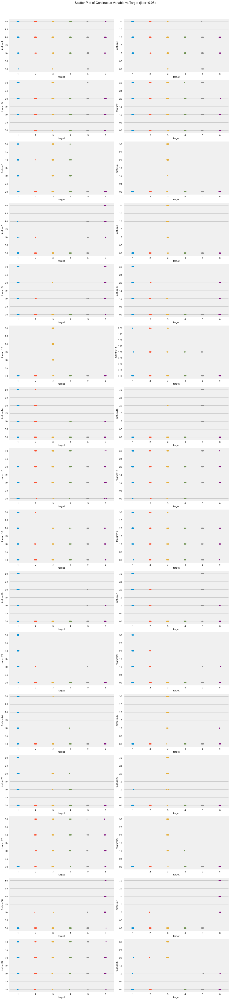

Total Number of Scatter Plots = 528


ValueError: Image size of 1080x71424 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 1080x71424 with 496 Axes>

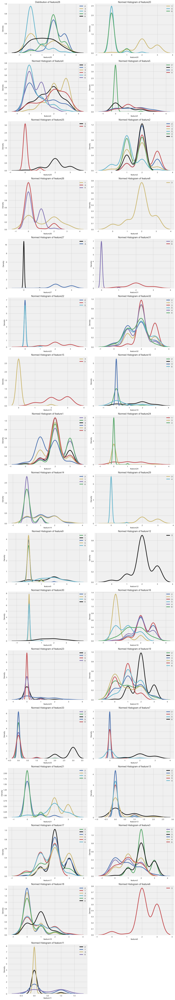

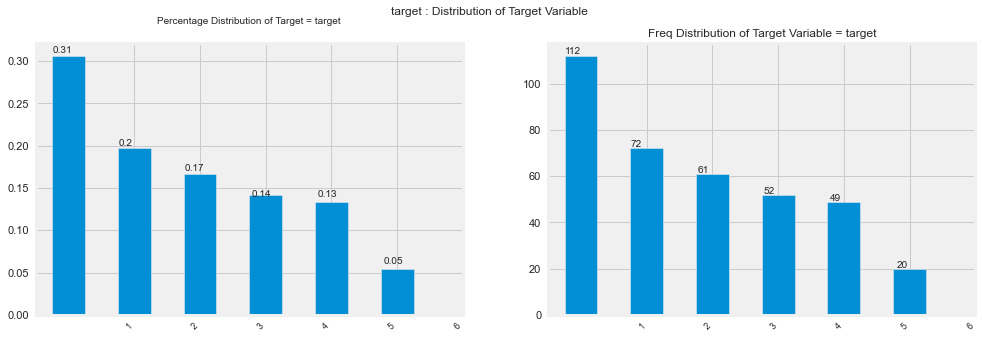

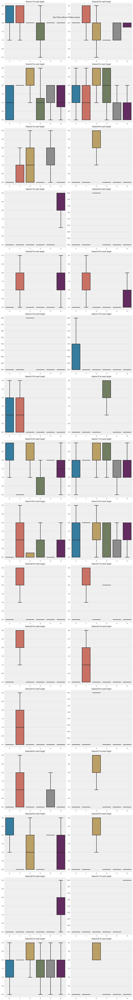

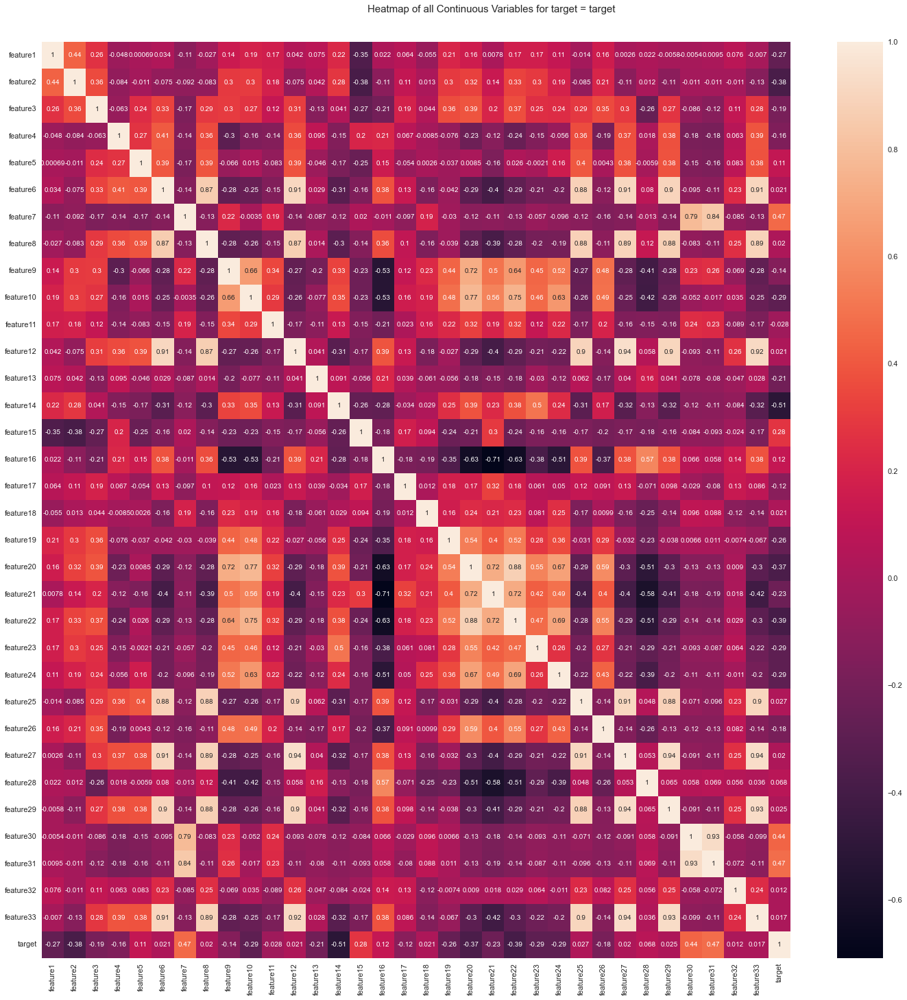

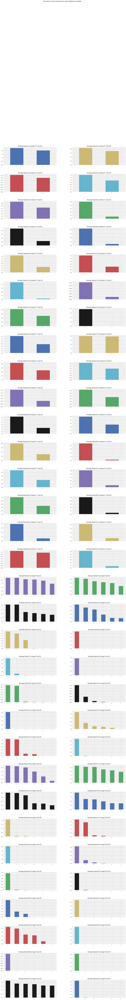

Could not draw wordcloud plot for age
Time to run AutoViz = 158 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


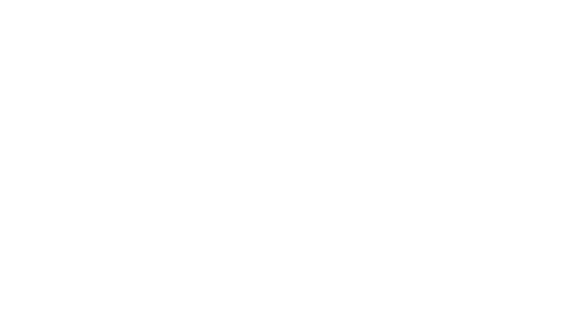

In [19]:
drft = AV.AutoViz(filename="", sep=",", depVar="target", dfte=df, max_cols_analyzed= 35)

## Data Preprocessing -

### Checking null values :

In [20]:
df[df["age"]=="?"]

,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13,feature14,feature15,feature16,feature17,feature18,feature19,feature20,feature21,feature22,feature23,feature24,feature25,feature26,feature27,feature28,feature29,feature30,feature31,feature32,feature33,age,target
33,2,2,1,0,0,0,0,0,1,0,1,0,0,2,0,0,2,1,2,2,1,2,0,1,0,0,0,0,0,0,0,0,0,?,1
34,2,1,0,0,2,0,0,0,0,0,0,0,0,0,0,2,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,?,4
35,2,2,1,2,0,0,0,0,0,0,0,0,0,2,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,?,2
36,2,1,2,3,2,3,0,2,0,0,1,1,0,0,0,2,1,1,2,0,0,0,0,0,1,0,2,0,2,0,0,0,3,?,3
262,2,1,0,2,0,0,0,0,0,0,0,0,0,0,2,1,3,2,2,1,3,0,0,0,0,0,0,2,0,0,0,3,0,?,5
263,1,1,1,3,0,0,0,0,0,0,0,0,0,0,3,2,3,1,2,2,2,0,0,0,0,0,0,3,0,0,0,2,0,?,5
264,1,1,0,2,0,0,0,0,1,0,0,0,0,0,3,2,3,2,1,1,3,0,0,0,0,0,0,2,0,0,0,3,0,?,5
265,1,1,0,3,0,0,0,0,0,0,0,0,0,0,2,1,3,1,1,0,2,0,1,0,0,0,0,2,0,0,0,3,0,?,5


In [21]:
df["age"] = df["age"].replace(to_replace="?", value=np.nan)

In [22]:
df[df["age"]=="?"]

,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13,feature14,feature15,feature16,feature17,feature18,feature19,feature20,feature21,feature22,feature23,feature24,feature25,feature26,feature27,feature28,feature29,feature30,feature31,feature32,feature33,age,target


In [23]:
df.isnull().sum()

feature1     0
feature2     0
feature3     0
feature4     0
feature5     0
feature6     0
feature7     0
feature8     0
feature9     0
feature10    0
feature11    0
feature12    0
feature13    0
feature14    0
feature15    0
feature16    0
feature17    0
feature18    0
feature19    0
feature20    0
feature21    0
feature22    0
feature23    0
feature24    0
feature25    0
feature26    0
feature27    0
feature28    0
feature29    0
feature30    0
feature31    0
feature32    0
feature33    0
age          8
target       0
dtype: int64

<AxesSubplot:xlabel='age', ylabel='Density'>

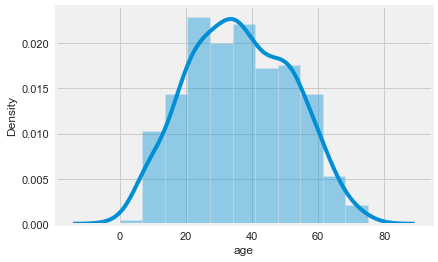

In [24]:
sns.distplot(df.age)

In [25]:
df.age.median()

35.0

In [26]:
df["age"] = df["age"].replace(to_replace=np.nan, value=df.age.median())

In [27]:
df["age"] = df.age.astype("int")

In [28]:
df.isnull().sum()

feature1     0
feature2     0
feature3     0
feature4     0
feature5     0
feature6     0
feature7     0
feature8     0
feature9     0
feature10    0
feature11    0
feature12    0
feature13    0
feature14    0
feature15    0
feature16    0
feature17    0
feature18    0
feature19    0
feature20    0
feature21    0
feature22    0
feature23    0
feature24    0
feature25    0
feature26    0
feature27    0
feature28    0
feature29    0
feature30    0
feature31    0
feature32    0
feature33    0
age          0
target       0
dtype: int64

### Checking Duplicate rows :

In [29]:
df.duplicated().sum()

0

### Handling Outliers :

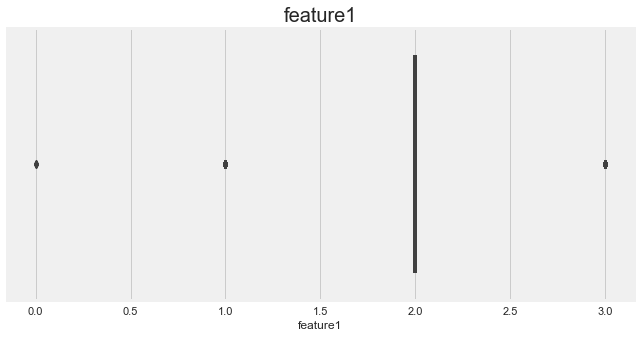

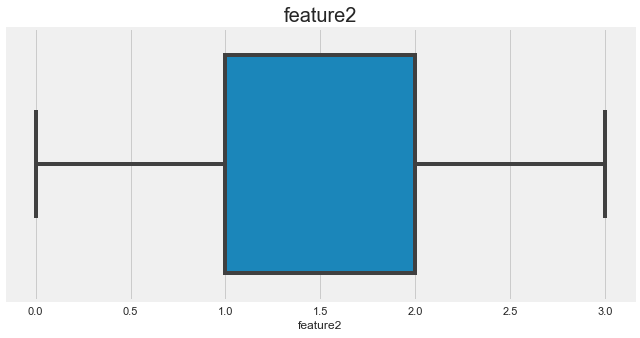

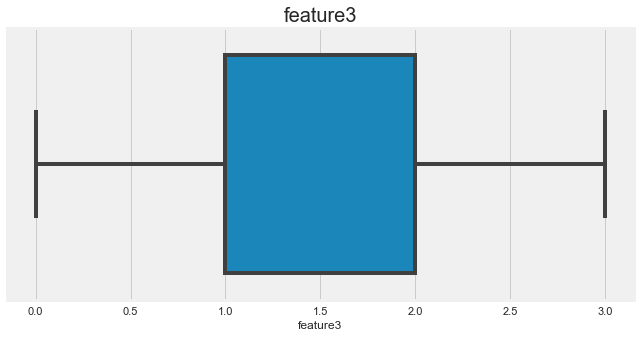

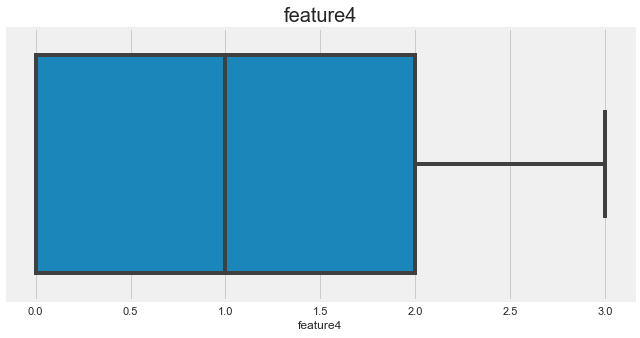

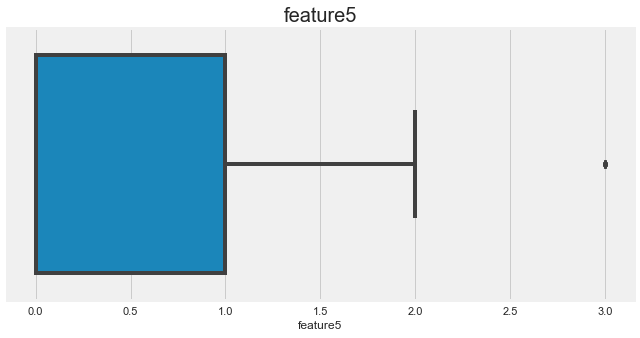

...

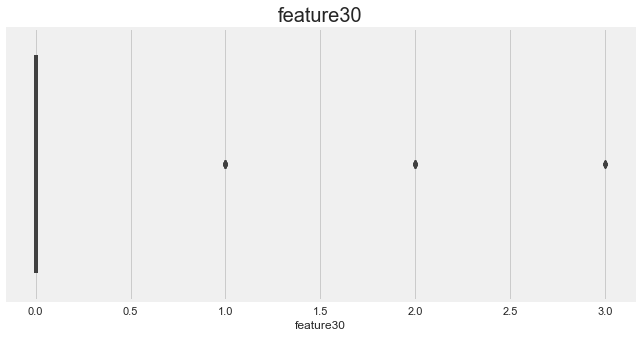

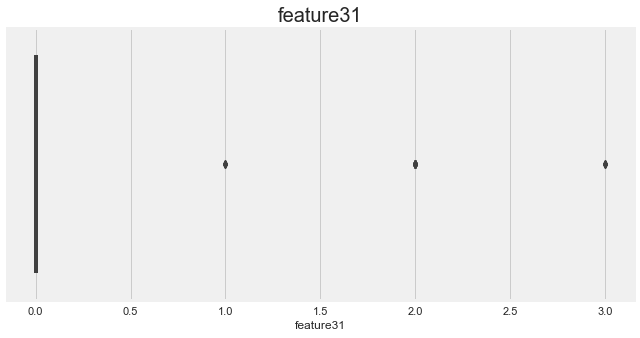

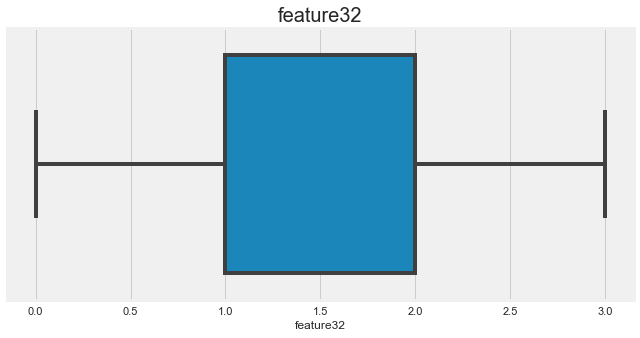

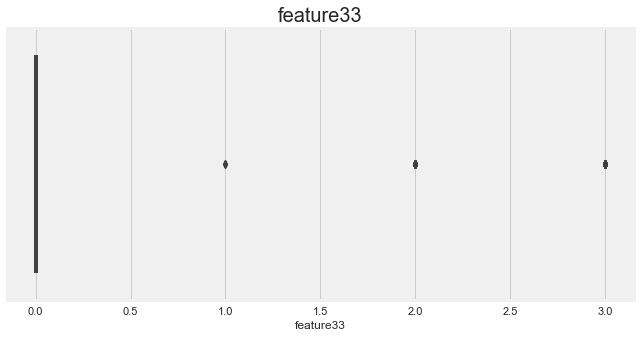

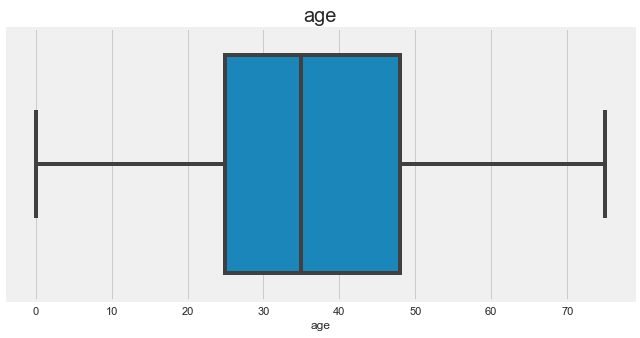

<Figure size 432x288 with 0 Axes>

In [30]:
p = 1
for col in df.drop(columns=["target"]):
    if p < 36:
        plt.figure(figsize=(10,5), facecolor="white")
        ax = plt.subplot(1,1,1)
        sns.boxplot(x=df[col])
        plt.title(col, fontsize=20)
        plt.show()
        p += 1 
plt.tight_layout()

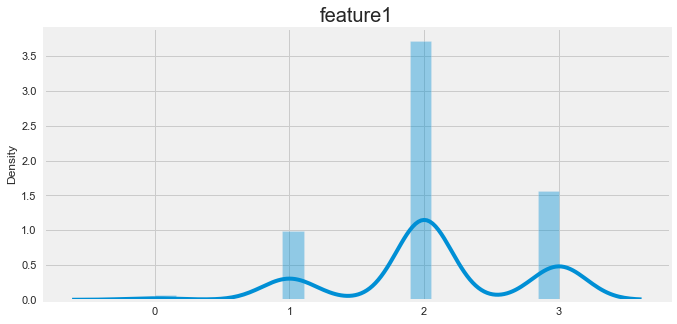

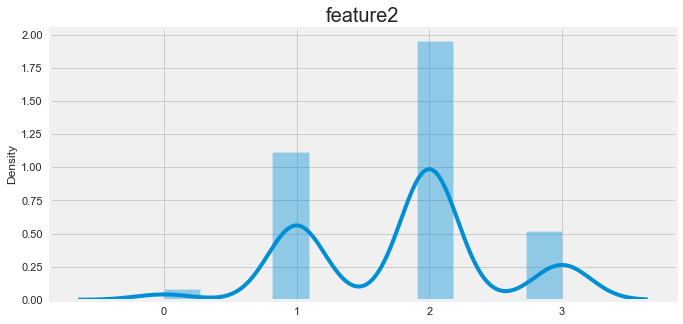

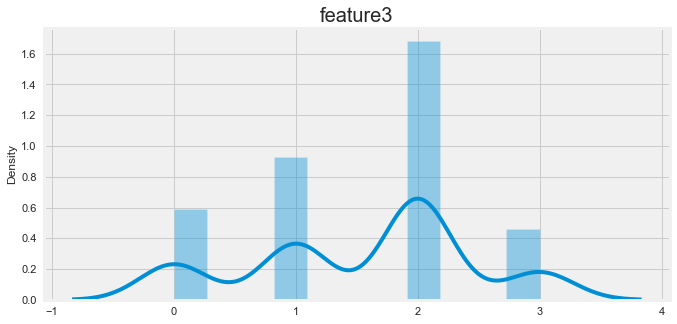

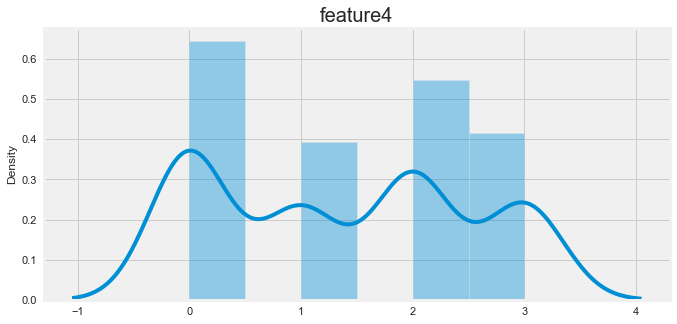

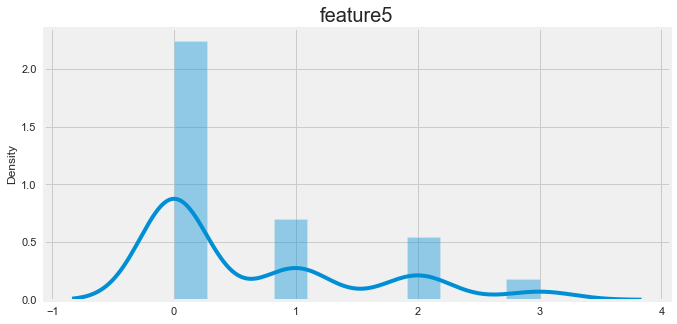

...

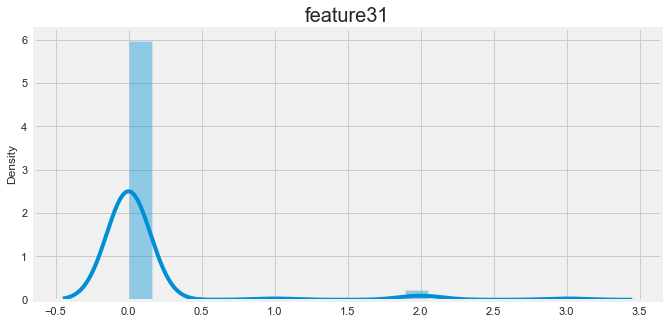

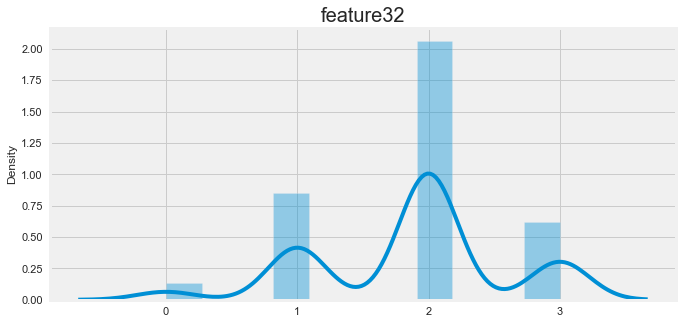

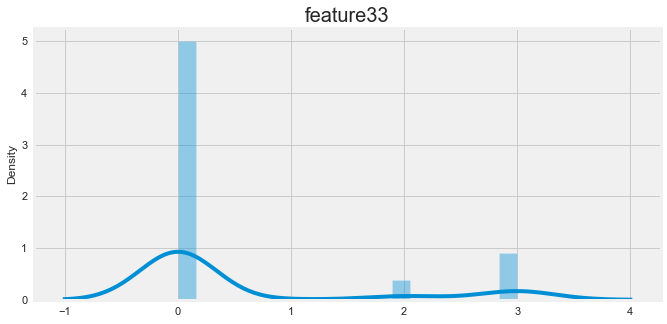

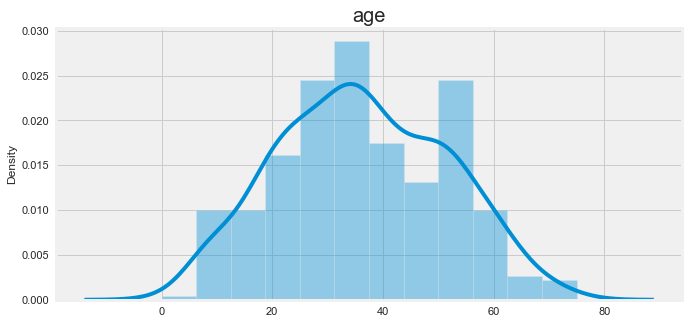

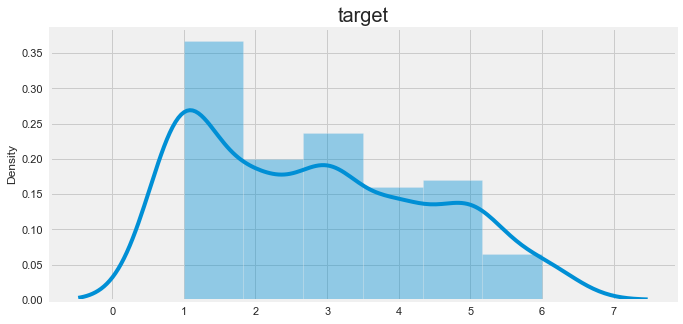

<Figure size 432x288 with 0 Axes>

In [31]:
p = 1
for col in df:
    if p < 36:
        plt.figure(figsize=(10,5), facecolor="white")
        ax = plt.subplot(1,1,1)
        sns.distplot(x=df[col])
        plt.title(col, fontsize=20)
        plt.show()
        p += 1 
plt.tight_layout()

No need to handle the outliers.

### Dividing the data into x and y :

In [32]:
## creating X and y :
X = df.drop(columns="target")
Y = df["target"]

### Scaling the data :

In [33]:
from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler()
scaled_X= scaler.fit_transform(X)

In [34]:
## creating new dataframe
df1 = pd.DataFrame(data=scaled_X, columns= X.columns)

In [35]:
df1

,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13,feature14,feature15,feature16,feature17,feature18,feature19,feature20,feature21,feature22,feature23,feature24,feature25,feature26,feature27,feature28,feature29,feature30,feature31,feature32,feature33,age
0,0.666667,0.666667,0.000000,1.000000,0.000000,0.000000,0.0,0.000000,0.333333,0.000000,0.0,0.000000,0.0,0.000000,0.0,1.000000,0.666667,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.0,0.333333,0.0,0.733333
1,1.000000,1.000000,1.000000,0.666667,0.333333,0.000000,0.0,0.000000,0.333333,0.333333,1.0,0.000000,0.0,0.333333,0.0,0.333333,0.666667,0.0,0.666667,0.666667,0.666667,0.666667,0.666667,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.333333,0.0,0.106667
2,0.666667,0.333333,0.666667,1.000000,0.333333,1.000000,0.0,1.000000,0.000000,0.000000,0.0,0.333333,0.0,0.000000,0.0,0.333333,0.666667,0.0,0.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.666667,0.000000,0.666667,1.000000,0.666667,0.0,0.0,0.666667,1.0,0.346667
3,0.666667,0.666667,0.666667,0.000000,0.000000,0.000000,0.0,0.000000,1.000000,0.666667,0.0,0.000000,0.0,1.000000,0.0,0.000000,0.666667,0.0,1.000000,0.666667,0.666667,0.666667,0.666667,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.0,1.000000,0.0,0.533333
4,0.666667,1.000000,0.666667,0.666667,0.666667,0.666667,0.0,0.666667,0.000000,0.000000,0.0,0.333333,0.0,0.000000,0.0,0.333333,0.666667,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.666667,0.666667,1.000000,0.666667,1.000000,0.0,0.0,0.666667,1.0,0.600000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
361,0.666667,0.333333,0.333333,0.000000,0.333333,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.333333,0.0,0.333333,0.333333,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.333333,0.000000,0.0,0.0,0.666667,0.0,0.333333
362,1.000000,0.666667,0.333333,0.000000,0.333333,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.666667,0.666667,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.333333,0.000000,0.333333,0.000000,0.0,0.0,0.666667,0.0,0.480000
363,1.000000,0.666667,0.666667,0.666667,1.000000,0.666667,0.0,0.666667,0.000000,0.000000,0.0,0.666667,1.0,0.000000,0.0,1.000000,1.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.0,0.0,0.666667,1.0,0.373333
364,0.666667,0.333333,1.000000,0.333333,0.666667,1.000000,0.0,0.666667,0.000000,0.000000,0.0,0.666667,0.0,0.000000,0.0,1.000000,0.666667,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.666667,0.000000,0.333333,0.0,0.0,0.666667,1.0,0.666667


### Applying PCA :

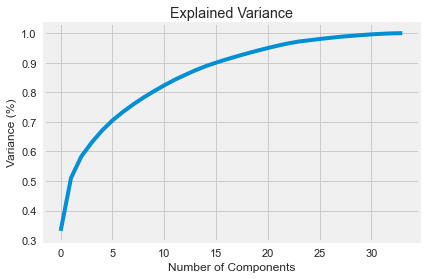

In [36]:
## getting the optimal number of pca
from sklearn.decomposition import PCA
pca = PCA()
principalComponents = pca.fit_transform(df1)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Explained Variance')
plt.show()

In [37]:
col = [] 
for n in range(1,28):
    col.append("pc{}".format(n))

In [38]:
pca = PCA(n_components=27) 
new_data = pca.fit_transform(df1)

# This will be the new data fed to the algorithm.
pca_x = pd.DataFrame(data = new_data, columns = col)

In [39]:
pca_x

,pc1,pc2,pc3,pc4,pc5,pc6,pc7,pc8,pc9,pc10,pc11,pc12,pc13,pc14,pc15,pc16,pc17,pc18,pc19,pc20,pc21,pc22,pc23,pc24,pc25,pc26,pc27
0,-0.457709,-0.939159,-0.161205,-0.428135,0.441944,-0.062091,-0.178922,-0.125438,-0.255380,-0.105450,-0.199439,0.122667,0.318628,0.127295,-0.203199,-0.472196,-0.183758,0.302200,-0.086494,-0.016102,0.034336,0.047445,-0.214128,-0.006690,0.018594,0.043985,0.102904
1,0.970862,0.551235,-0.272388,0.009355,0.633765,-0.247095,0.009060,0.558567,0.336437,-0.310020,0.147655,-0.327441,-0.269587,-0.038987,-0.170572,-0.224672,-0.097101,-0.312497,0.183025,-0.180516,0.049030,0.147799,-0.014328,0.290150,0.091523,0.037940,0.074801
2,-1.623534,0.766445,-0.020557,-0.065088,0.123320,-0.284835,-0.111739,-0.287861,0.005723,0.117238,-0.576280,-0.273621,0.020791,-0.328890,0.264624,0.043474,-0.033652,-0.118391,0.134521,-0.137228,0.095927,0.180638,-0.108014,-0.118033,0.133440,-0.089768,0.149273
3,1.453323,0.721074,-0.404307,-0.196472,-0.521869,-0.195548,0.424728,-0.154629,-0.608114,-0.139766,-0.145439,0.083119,-0.007803,-0.456680,-0.290840,0.343605,0.286507,0.071402,0.029728,0.042738,-0.163863,-0.252596,0.034926,-0.092586,0.033130,0.149240,0.069026
4,-1.506097,0.926263,-0.141308,-0.092998,-0.217837,0.168116,-0.300793,0.132406,-0.107101,-0.366958,-0.337629,-0.115889,0.401345,-0.050902,0.218227,0.068310,-0.013001,0.205957,0.402157,0.258974,-0.034287,-0.080669,0.182040,-0.085195,-0.191879,-0.049727,0.011262
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
361,-0.089583,-0.734730,-0.141805,0.062565,-0.346819,0.507826,0.134216,0.260540,-0.104160,-0.043653,-0.024008,-0.222097,-0.127543,-0.071515,0.206997,0.066285,0.130365,-0.108778,-0.031989,-0.050113,-0.016831,-0.035316,-0.071638,-0.092242,0.008662,-0.038181,-0.045630
362,-0.144572,-0.648442,-0.305177,-0.051408,-0.380008,0.296236,-0.187930,0.225220,-0.020314,-0.268917,0.164795,0.070143,-0.044087,0.282456,0.091785,-0.013786,0.273545,0.161713,0.053669,0.010921,-0.094310,-0.013982,-0.002099,0.085878,0.025442,-0.033132,0.001386
363,-1.883871,1.067416,0.013832,-0.029083,0.018798,0.205555,0.197621,0.215568,0.006517,-0.130430,0.478918,-0.326554,0.164778,0.879150,-0.266707,0.442251,0.066002,-0.087062,0.161773,0.055103,0.252276,-0.087635,-0.003273,-0.027323,0.104061,-0.113682,0.066759
364,-1.626015,0.886809,-0.000025,0.258683,-0.402338,0.421972,0.020383,0.302969,0.057854,-0.135836,0.276165,-0.056963,0.029591,0.106602,-0.251274,-0.082365,-0.023460,-0.103455,-0.281491,-0.088154,0.007416,0.108014,0.126454,-0.050194,0.184565,-0.076863,0.064102


In [40]:
pca_x = scaler.fit_transform(pca_x)

### Feature Selection :

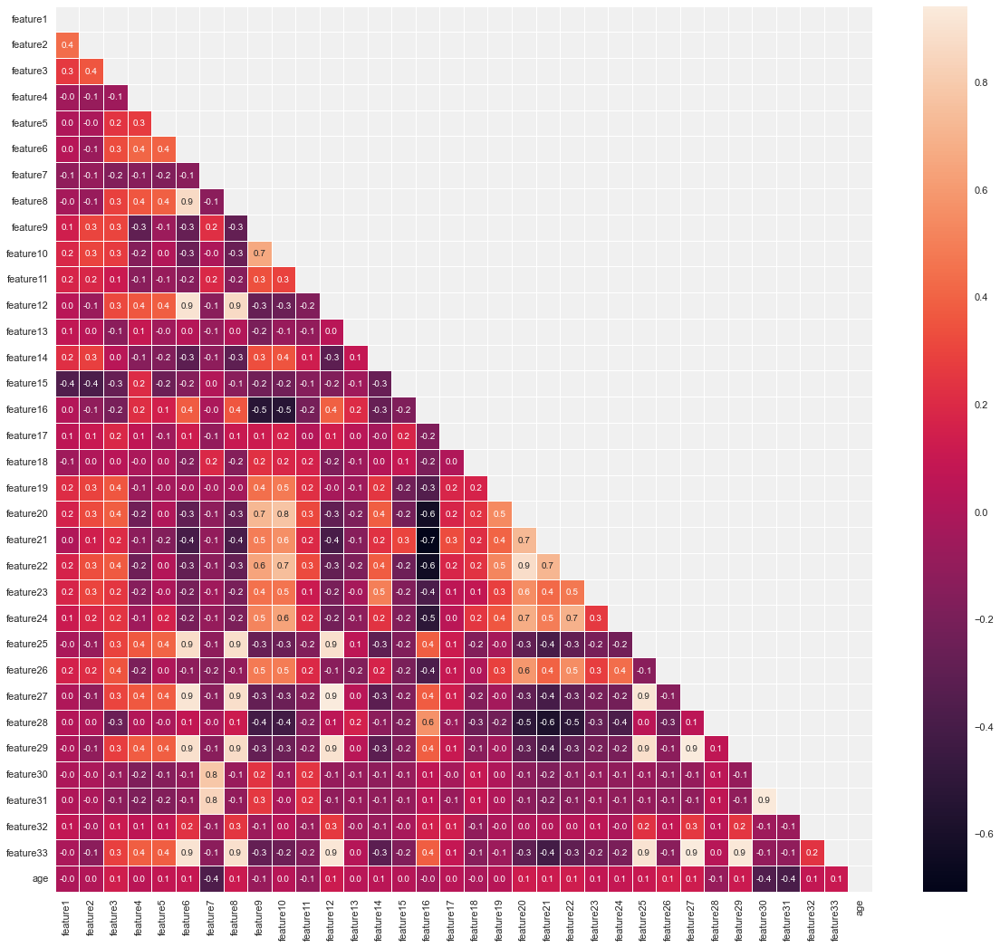

In [41]:
f,ax = plt.subplots(figsize=(18, 18))
matrix = np.triu(X.corr())
sns.heatmap(X.corr(), annot=True, linewidths=.5, fmt= '.1f',ax=ax, mask=matrix)
plt.show()

### Splitting data into train and test :

In [42]:
## preparing training and testing data
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(pca_x, Y, test_size=0.3, random_state=56)

In [43]:
y_train.value_counts()

1    78
3    52
2    43
4    39
5    31
6    13
Name: target, dtype: int64

### Balancing the data :

In [44]:
## Balacing the data
from collections import Counter    # importing counter to check count of each label
from imblearn.over_sampling import SMOTE
sm=SMOTE()
print(Counter(y_train))   # checking count for each class 
x_smote,y_smote=sm.fit_resample(x_train,y_train)   #applying sampling on target variable 
print(Counter(y_smote))   # checking count after sampling for  each class

Counter({1: 78, 3: 52, 2: 43, 4: 39, 5: 31, 6: 13})
Counter({3: 78, 1: 78, 2: 78, 5: 78, 6: 78, 4: 78})


In [45]:
y_smote.value_counts()

3    78
1    78
2    78
5    78
6    78
4    78
Name: target, dtype: int64

## Model Selection and creation -

In [46]:
import xgboost
from xgboost import XGBClassifier
xgb  = XGBClassifier()
xgb.fit(x_smote,y_smote)
y_hat = xgb.predict(x_test)
y_train_hat = xgb.predict(x_smote)
y_test_hat = xgb.predict(x_test)

[20:55:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [47]:
from sklearn.svm import SVC
from sklearn.model_selection import cross_val_score
SVC = SVC()
SVC.fit(x_smote,y_smote)
y_train_hat1 = SVC.predict(x_smote)
y_test_hat1 = SVC.predict(x_test)

In [48]:
from sklearn.linear_model import LogisticRegression
LR=LogisticRegression(multi_class='ovr')
LR.fit(x_smote,y_smote)
y_train_hat2 = LR.predict(x_smote)
y_test_hat2 = LR.predict(x_test)

In [49]:
from sklearn.tree import DecisionTreeClassifier#importing decision tree from sklearn.tree
dt=DecisionTreeClassifier()
dt.fit(x_smote,y_smote)
y_train_hat3 = dt.predict(x_smote)
y_test_hat3 = dt.predict(x_test)

In [50]:
from sklearn.ensemble import RandomForestClassifier#importing randomforest

RF = RandomForestClassifier(n_estimators=100)
RF.fit(x_smote,y_smote)
y_train_hat4 = RF.predict(x_smote)
y_test_hat4 = RF.predict(x_test)

In [51]:
## taking optimal k to determine how many nearest neighbors  to create
from sklearn.neighbors import KNeighborsClassifier
# create a list to store the error values for each k
error_rate = []

# Will take some time
for i in range(1,11):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(x_smote,y_smote)
    pred_i = knn.predict(x_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

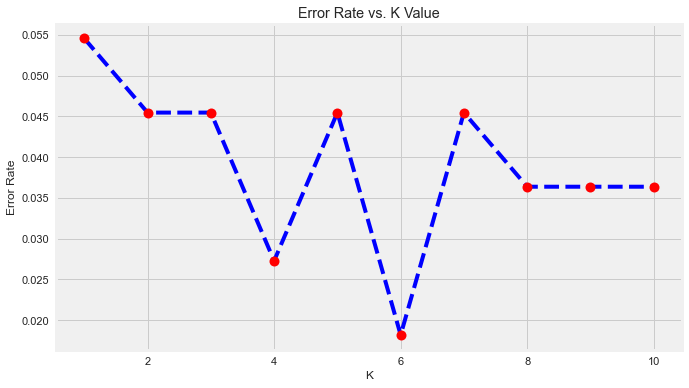

In [52]:
# Lets plot the k-value and error rate

plt.figure(figsize=(10,6))
plt.plot(range(1,11),error_rate,color='blue', linestyle='dashed', 
         marker='o',markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

In [53]:
KNN = KNeighborsClassifier(n_neighbors=6)
KNN.fit(x_smote,y_smote)
y_train_hat5 = KNN.predict(x_smote)
y_test_hat5 = KNN.predict(x_test)

## Model Evaluation -

In [54]:
from sklearn.metrics import accuracy_score,classification_report,f1_score,plot_confusion_matrix

In [55]:
print("XG-boost model :".upper())
print(classification_report(y_test,y_test_hat))

XG-BOOST MODEL :
              precision    recall  f1-score   support

           1       0.92      1.00      0.96        34
           2       1.00      0.83      0.91        18
           3       1.00      1.00      1.00        20
           4       0.77      1.00      0.87        10
           5       1.00      0.95      0.98        21
           6       1.00      0.71      0.83         7

    accuracy                           0.95       110
   macro avg       0.95      0.92      0.92       110
weighted avg       0.95      0.95      0.94       110



In [56]:
print("Support Vector Classifier :".upper())
print(classification_report(y_test,y_test_hat1))

SUPPORT VECTOR CLASSIFIER :
              precision    recall  f1-score   support

           1       0.94      1.00      0.97        34
           2       1.00      0.89      0.94        18
           3       1.00      1.00      1.00        20
           4       0.91      1.00      0.95        10
           5       1.00      1.00      1.00        21
           6       1.00      0.86      0.92         7

    accuracy                           0.97       110
   macro avg       0.98      0.96      0.96       110
weighted avg       0.97      0.97      0.97       110



In [57]:
print("logistic regression :".upper())
print(classification_report(y_test,y_test_hat2))

LOGISTIC REGRESSION :
              precision    recall  f1-score   support

           1       1.00      1.00      1.00        34
           2       1.00      0.94      0.97        18
           3       1.00      1.00      1.00        20
           4       0.91      1.00      0.95        10
           5       1.00      1.00      1.00        21
           6       1.00      1.00      1.00         7

    accuracy                           0.99       110
   macro avg       0.98      0.99      0.99       110
weighted avg       0.99      0.99      0.99       110



In [58]:
print("decision tree :".upper())
print(classification_report(y_test,y_test_hat3))

DECISION TREE :
              precision    recall  f1-score   support

           1       1.00      1.00      1.00        34
           2       0.92      0.61      0.73        18
           3       1.00      1.00      1.00        20
           4       0.53      0.90      0.67        10
           5       1.00      0.95      0.98        21
           6       1.00      1.00      1.00         7

    accuracy                           0.92       110
   macro avg       0.91      0.91      0.90       110
weighted avg       0.94      0.92      0.92       110



In [59]:
print("random forest :".upper())
print(classification_report(y_test,y_test_hat4))

RANDOM FOREST :
              precision    recall  f1-score   support

           1       1.00      1.00      1.00        34
           2       1.00      1.00      1.00        18
           3       1.00      1.00      1.00        20
           4       1.00      1.00      1.00        10
           5       1.00      1.00      1.00        21
           6       1.00      1.00      1.00         7

    accuracy                           1.00       110
   macro avg       1.00      1.00      1.00       110
weighted avg       1.00      1.00      1.00       110



In [60]:
print("KNN classifier :".upper())
print(classification_report(y_test,y_test_hat5))

KNN CLASSIFIER :
              precision    recall  f1-score   support

           1       1.00      1.00      1.00        34
           2       1.00      0.89      0.94        18
           3       1.00      1.00      1.00        20
           4       0.83      1.00      0.91        10
           5       1.00      1.00      1.00        21
           6       1.00      1.00      1.00         7

    accuracy                           0.98       110
   macro avg       0.97      0.98      0.98       110
weighted avg       0.98      0.98      0.98       110



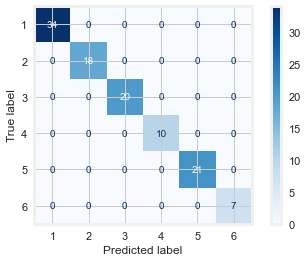

In [65]:
plot_confusion_matrix(RF,x_test,y_test,cmap=plt.cm.Blues)

## Saving the best model -

In [ ]:
import pickle
# open a file, where you ant to store the data
filename = open('skin_disorder.pkl', 'wb')

# dump information to that file
pickle.dump(RF, filename)

## Conclusion -

- Here we are selecting random forest model because as we can see it's totally fiting the testing data.

# ---------------------------------------------THE END------------------------------------------------